# Data Exploration

In [1]:
# For dataframe operations
import numpy as np
import pandas as pd

# For visualisation
import plotly.express as px
import seaborn as sns

### Storage Variables

These point the program to the directory containing the pre-processed audio data, and saves the current dataframes as temporary files so that consecutive runs can pick up where the previous run left off.

In [2]:
import config

### Universal Variables

These would be used to perform many repeated computations e.g. normalisation.

In [3]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

## Loading in the Dataset

Data is loaded from the `./features.pkl.pbz2` files located in their respective `data/extracted/playlist-name` directories. All data is concatenated into a single DataFrame, with the `playlist` column indicating which folder they came from. The freshly loaded dataset is then saved to the `temp` folder for future access if needed.

In [4]:
from src.helpers import PandasAudioRepository
dataset = PandasAudioRepository.load_all_feature_datasets(config.extracted_dir)
dataset.to_pickle(config.fresh_load_dataset_dir, compression='bz2')

We will only aim to visualise numeric data. Higher-dimensional data such as the trajectory and tonnetz representations will be left for the next step: MDS Embedding.

In [5]:
dataset

,song_name,artist,playlist,zero_crossings_mean,zero_crossings_var,bpm,spectral_centroid_mean,spectral_centroid_var,spectral_rolloff_mean,spectral_rolloff_var,...,mfcc_var_7,mfcc_mean_8,mfcc_var_8,mfcc_mean_9,mfcc_var_9,mfcc_mean_10,mfcc_var_10,chord_trajectory,note_trajectory,tonnetz
0,Ivan Sings,Aram Khachaturian,kino,0.030815,0.029865,143.554688,728.505121,164591.144472,1044.706810,1.492931e+06,...,59.754135,-7.222707,53.279484,-6.638159,63.120949,-7.461281,58.827705,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.013063414466682632, -0.1234544114431008, -..."
1,"Prélude in E Minor, Op. 28, No. 4",Frédéric Chopin,kino,0.028196,0.027401,103.359375,615.425486,95544.686241,892.440162,8.328338e+05,...,66.532372,-7.709404,67.271782,-8.138650,51.361748,-8.201083,51.866173,"[12.0, 0.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 2.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04845747056013336, 0.02526867983571359, 0.0..."
2,Above the Trees,Kino,kino,0.052121,0.049405,143.554688,1053.924804,248527.612506,1937.848230,1.480721e+06,...,113.514336,-4.448510,74.239128,-2.306997,76.906097,-2.640234,74.699959,"[17.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.05386779890017199, -0.027705138076340542, ..."
3,All,Kino,kino,0.044240,0.042283,161.499023,619.260455,49458.448746,981.976649,2.497879e+05,...,109.742783,3.967615,61.414219,4.160887,66.464058,-0.379875,82.376328,"[3.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.007021180094766433, 0.0103778882764489, 0.2..."
4,Anew,Kino,kino,0.048969,0.046571,161.499023,677.808914,72961.813450,1098.534181,4.831254e+05,...,75.191750,-0.318088,72.683647,-0.499459,70.440079,-3.557541,71.182747,"[105.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 5.0, 0.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.047920894082682464, 0.024257793432034533, 0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,Tenderness - Woven Remix,Tony Anderson,tony-anderson,0.050498,0.047948,99.384014,1690.752815,996877.763828,3788.666509,6.661065e+06,...,85.660057,-0.473025,55.165321,1.394155,64.965172,-3.817915,56.059143,"[49.0, 0.0, 0.0, 6.0, 0.0, 3.0, 0.0, 0.0, 17.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.03940684682031146, 0.1047418567047819, 0.03..."
421,Tenderness,Tony Anderson,tony-anderson,0.019365,0.018990,151.999081,500.969118,144860.433188,764.697603,1.021311e+06,...,42.235184,1.522114,30.496746,-3.054044,27.486416,-6.413583,28.495449,"[46.0, 0.0, 0.0, 2.0, 0.0, 1.0, 0.0, 0.0, 8.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0033105168498387544, 0.024618212288380806,..."
422,Cambodia - Ross Lara Remix,Tony Anderson,tony-anderson,0.053039,0.050226,129.199219,1618.810406,687875.800819,3493.059627,5.250681e+06,...,62.413822,-2.939895,52.945293,2.519716,61.408394,-2.011139,51.967083,"[246.0, 1.0, 0.0, 5.0, 0.0, 0.0, 0.0, 0.0, 2.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0015526135778904798, 0.1095253043758808, 0...."
423,Cambodia,Tony Anderson,tony-anderson,0.042857,0.041020,129.199219,1234.479968,276949.182834,2474.291523,1.718215e+06,...,118.341034,-1.348665,86.386292,1.038753,90.882286,-4.584059,92.075935,"[295.0, 0.0, 0.0, 5.0, 0.0, 2.0, 0.0, 0.0, 0.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.18101009841973742, -0.004248825583113958, ..."


## Cleaning the Dataset

First, duplicated rows are identified by having the same `song_name` and `artist` before getting dropped. The combination of two columns is necessary as song names are not unique.

In [6]:
dataset[dataset[['song_name', 'artist']].duplicated()]

,song_name,artist,playlist,zero_crossings_mean,zero_crossings_var,bpm,spectral_centroid_mean,spectral_centroid_var,spectral_rolloff_mean,spectral_rolloff_var,...,mfcc_var_7,mfcc_mean_8,mfcc_var_8,mfcc_mean_9,mfcc_var_9,mfcc_mean_10,mfcc_var_10,chord_trajectory,note_trajectory,tonnetz


In this case, there are no duplicates found.

In [7]:
dataset = dataset.drop_duplicates(subset=['song_name', 'artist'])
dataset

,song_name,artist,playlist,zero_crossings_mean,zero_crossings_var,bpm,spectral_centroid_mean,spectral_centroid_var,spectral_rolloff_mean,spectral_rolloff_var,...,mfcc_var_7,mfcc_mean_8,mfcc_var_8,mfcc_mean_9,mfcc_var_9,mfcc_mean_10,mfcc_var_10,chord_trajectory,note_trajectory,tonnetz
0,Ivan Sings,Aram Khachaturian,kino,0.030815,0.029865,143.554688,728.505121,164591.144472,1044.706810,1.492931e+06,...,59.754135,-7.222707,53.279484,-6.638159,63.120949,-7.461281,58.827705,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.013063414466682632, -0.1234544114431008, -..."
1,"Prélude in E Minor, Op. 28, No. 4",Frédéric Chopin,kino,0.028196,0.027401,103.359375,615.425486,95544.686241,892.440162,8.328338e+05,...,66.532372,-7.709404,67.271782,-8.138650,51.361748,-8.201083,51.866173,"[12.0, 0.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 2.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04845747056013336, 0.02526867983571359, 0.0..."
2,Above the Trees,Kino,kino,0.052121,0.049405,143.554688,1053.924804,248527.612506,1937.848230,1.480721e+06,...,113.514336,-4.448510,74.239128,-2.306997,76.906097,-2.640234,74.699959,"[17.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.05386779890017199, -0.027705138076340542, ..."
3,All,Kino,kino,0.044240,0.042283,161.499023,619.260455,49458.448746,981.976649,2.497879e+05,...,109.742783,3.967615,61.414219,4.160887,66.464058,-0.379875,82.376328,"[3.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.007021180094766433, 0.0103778882764489, 0.2..."
4,Anew,Kino,kino,0.048969,0.046571,161.499023,677.808914,72961.813450,1098.534181,4.831254e+05,...,75.191750,-0.318088,72.683647,-0.499459,70.440079,-3.557541,71.182747,"[105.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 5.0, 0.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.047920894082682464, 0.024257793432034533, 0..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,Tenderness - Woven Remix,Tony Anderson,tony-anderson,0.050498,0.047948,99.384014,1690.752815,996877.763828,3788.666509,6.661065e+06,...,85.660057,-0.473025,55.165321,1.394155,64.965172,-3.817915,56.059143,"[49.0, 0.0, 0.0, 6.0, 0.0, 3.0, 0.0, 0.0, 17.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.03940684682031146, 0.1047418567047819, 0.03..."
421,Tenderness,Tony Anderson,tony-anderson,0.019365,0.018990,151.999081,500.969118,144860.433188,764.697603,1.021311e+06,...,42.235184,1.522114,30.496746,-3.054044,27.486416,-6.413583,28.495449,"[46.0, 0.0, 0.0, 2.0, 0.0, 1.0, 0.0, 0.0, 8.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.0033105168498387544, 0.024618212288380806,..."
422,Cambodia - Ross Lara Remix,Tony Anderson,tony-anderson,0.053039,0.050226,129.199219,1618.810406,687875.800819,3493.059627,5.250681e+06,...,62.413822,-2.939895,52.945293,2.519716,61.408394,-2.011139,51.967083,"[246.0, 1.0, 0.0, 5.0, 0.0, 0.0, 0.0, 0.0, 2.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0015526135778904798, 0.1095253043758808, 0...."
423,Cambodia,Tony Anderson,tony-anderson,0.042857,0.041020,129.199219,1234.479968,276949.182834,2474.291523,1.718215e+06,...,118.341034,-1.348665,86.386292,1.038753,90.882286,-4.584059,92.075935,"[295.0, 0.0, 0.0, 5.0, 0.0, 2.0, 0.0, 0.0, 0.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.18101009841973742, -0.004248825583113958, ..."


## Summary Exploration

Column types are first analysed, followed by describing the numerical data of the dataset. This gives an idea of the values present in each column and their overall distribution.

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 425 entries, 0 to 424
Data columns (total 37 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   song_name               425 non-null    object 
 1   artist                  425 non-null    object 
 2   playlist                425 non-null    object 
 3   zero_crossings_mean     425 non-null    float64
 4   zero_crossings_var      425 non-null    float64
 5   bpm                     425 non-null    float64
 6   spectral_centroid_mean  425 non-null    float64
 7   spectral_centroid_var   425 non-null    float64
 8   spectral_rolloff_mean   425 non-null    float64
 9   spectral_rolloff_var    425 non-null    float64
 10  spectral_flux_mean      425 non-null    float32
 11  spectral_flux_var       425 non-null    float32
 12  spectral_flatness_mean  425 non-null    float32
 13  spectral_flatness_var   425 non-null    float32
 14  mfcc_mean_1             425 non-null    fl

In [9]:
dataset.describe()

,zero_crossings_mean,zero_crossings_var,bpm,spectral_centroid_mean,spectral_centroid_var,spectral_rolloff_mean,spectral_rolloff_var,spectral_flux_mean,spectral_flux_var,spectral_flatness_mean,...,mfcc_mean_6,mfcc_var_6,mfcc_mean_7,mfcc_var_7,mfcc_mean_8,mfcc_var_8,mfcc_mean_9,mfcc_var_9,mfcc_mean_10,mfcc_var_10
count,425.000000,425.000000,425.000000,425.000000,4.250000e+02,425.000000,4.250000e+02,425.000000,425.000000,425.000000,...,425.000000,425.000000,425.000000,425.000000,425.000000,425.000000,425.000000,425.000000,425.000000,425.000000
mean,0.068247,0.062974,118.881701,1612.110251,5.836493e+05,3344.808260,3.000150e+06,1.025450,1.200097,0.012175,...,-1.520768,108.674721,0.248322,105.328766,-3.100562,85.651230,0.719739,88.210449,-3.911685,77.358086
std,0.024842,0.021236,26.670409,621.665418,3.926807e+05,1530.488114,1.922949e+06,0.267994,1.233624,0.009917,...,5.387770,48.787312,6.231655,48.386257,4.719793,35.024391,5.011305,36.894077,4.306118,32.183571
min,0.017774,0.017458,51.679688,452.890076,3.080460e+04,609.732442,1.778121e+05,0.372851,0.042488,0.000120,...,-20.940351,30.233118,-24.322084,26.168812,-19.364157,24.652981,-13.197424,22.266815,-17.753010,19.250496
25%,0.050498,0.047948,103.359375,1053.924804,2.485276e+05,1934.969784,1.304344e+06,0.817608,0.321169,0.004952,...,-4.848584,72.880699,-3.295691,70.939827,-6.072610,57.844742,-2.245395,62.703678,-6.632850,52.887833
50%,0.067258,0.062734,117.453835,1681.554160,5.376993e+05,3506.420781,2.786610e+06,1.006934,0.826973,0.010074,...,-1.269242,100.019569,0.996508,97.110031,-2.672228,82.531425,1.366200,87.121574,-3.595747,73.986664
75%,0.085428,0.078130,135.999178,2093.130802,8.305544e+05,4574.155554,4.538182e+06,1.206282,1.616824,0.016569,...,1.599307,136.208328,4.754464,134.325226,0.016591,107.728416,4.232615,106.688858,-1.037467,96.011566
max,0.166130,0.138531,215.332031,3025.139855,2.868023e+06,6472.216209,9.942325e+06,1.811939,7.188649,0.074629,...,17.618992,325.466431,18.190758,316.072784,14.152213,214.324692,12.275959,248.312164,8.037683,240.011642


## Counts by Categorical Data

The `song_name` column is mostly unique and serves as the main identifier for a song. `artist` and `playlist` occur more frequently and grouping songs by these features can be a good way of getting deeper insights from the data.

In [10]:
px.bar(
    dataset['artist'].value_counts(),
    x=dataset['artist'].value_counts().index,
    y='artist',
    title='Artists Distribution'
)

In this case, `artist` is still highly unique and might not be a good variable analyse trends on.

In [11]:
px.bar(
    dataset['playlist'].value_counts(),
    x=dataset['playlist'].value_counts().index,
    y='playlist',
    title='Playlists Distribution'
)

However, all songs only come from 8 playlists and can be easily analysed for inter-playlist trends that allow us to discriminate between songs from different playlists.

## Data Profiling

A report is generated using the `ydata_profiling` library, outputting the report as a large `.html` file due to the number of features present. Distributions for each column and the pairwise column covariances are shown in this report.

In [12]:
from ydata_profiling import ProfileReport

report = ProfileReport(dataset, title='Exploratory Data Analysis')

In [13]:
# Generates a very large report, only uncomment when necessary
# report.to_file(config.report_output_dir)

## Distributions and Correlations

The correlations for each column is computed here and visualised in a heatmap. Additionally, a high-resolution image to output a pair plot of all distributions and correlations coloured by playlist is generated.

In [14]:
correlations = dataset.corr(numeric_only=True)
correlations

,zero_crossings_mean,zero_crossings_var,bpm,spectral_centroid_mean,spectral_centroid_var,spectral_rolloff_mean,spectral_rolloff_var,spectral_flux_mean,spectral_flux_var,spectral_flatness_mean,...,mfcc_mean_6,mfcc_var_6,mfcc_mean_7,mfcc_var_7,mfcc_mean_8,mfcc_var_8,mfcc_mean_9,mfcc_var_9,mfcc_mean_10,mfcc_var_10
zero_crossings_mean,1.000000,0.999092,-0.089081,0.908291,0.496603,0.862605,0.408635,0.577111,0.327436,0.828202,...,-0.075814,0.220024,0.258348,0.290747,0.056137,0.285031,0.428491,0.250429,0.119494,0.168311
zero_crossings_var,0.999092,1.000000,-0.089341,0.913654,0.508082,0.869104,0.422946,0.586901,0.333237,0.817841,...,-0.079909,0.230537,0.254629,0.302669,0.051937,0.297405,0.430325,0.265316,0.113500,0.182132
bpm,-0.089081,-0.089341,1.000000,-0.056326,-0.015742,-0.042274,0.018234,-0.054465,-0.071908,-0.114755,...,0.029062,0.045842,-0.012289,0.000534,0.002895,-0.010931,-0.046242,-0.002966,-0.040089,-0.008234
spectral_centroid_mean,0.908291,0.913654,-0.056326,1.000000,0.644724,0.992576,0.625652,0.758310,0.498130,0.779141,...,0.039482,0.336616,0.332506,0.382572,0.153081,0.395697,0.544561,0.329276,0.121250,0.261887
spectral_centroid_var,0.496603,0.508082,-0.015742,0.644724,1.000000,0.659887,0.930009,0.715434,0.662666,0.499264,...,-0.020053,0.541982,0.085501,0.492512,0.019114,0.534932,0.282001,0.455321,-0.019924,0.396583
spectral_rolloff_mean,0.862605,0.869104,-0.042274,0.992576,0.659887,1.000000,0.662660,0.773123,0.515784,0.745273,...,0.060431,0.347936,0.337870,0.383653,0.168154,0.402321,0.559452,0.334307,0.117098,0.277431
spectral_rolloff_var,0.408635,0.422946,0.018234,0.625652,0.930009,0.662660,1.000000,0.687231,0.607843,0.377024,...,0.032614,0.543284,0.055838,0.520656,0.051869,0.569008,0.310280,0.482584,-0.088540,0.468613
spectral_flux_mean,0.577111,0.586901,-0.054465,0.758310,0.715434,0.773123,0.687231,1.000000,0.857904,0.548325,...,0.007921,0.534308,0.266230,0.480687,0.100601,0.550048,0.435332,0.419625,0.096422,0.391608
spectral_flux_var,0.327436,0.333237,-0.071908,0.498130,0.662666,0.515784,0.607843,0.857904,1.000000,0.424113,...,-0.033101,0.484427,0.158925,0.388603,0.017768,0.459945,0.239920,0.316877,0.046284,0.319413
spectral_flatness_mean,0.828202,0.817841,-0.114755,0.779141,0.499264,0.745273,0.377024,0.548325,0.424113,1.000000,...,-0.016668,0.177544,0.329388,0.196522,0.118648,0.198082,0.393332,0.138130,0.220385,0.051316


<AxesSubplot: >

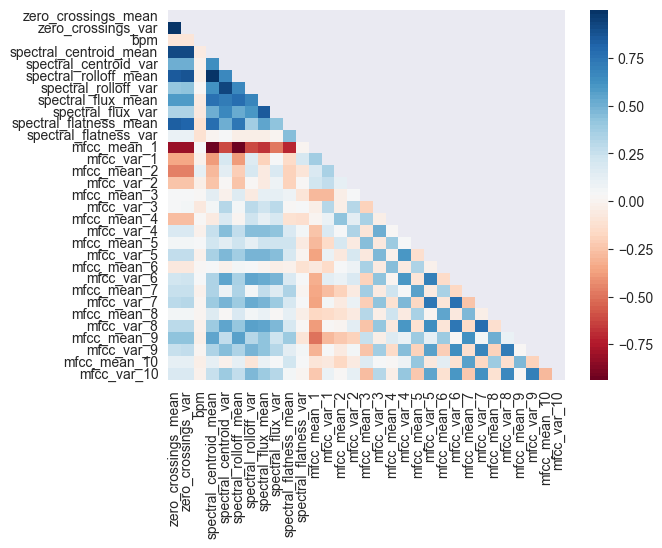

In [15]:
# Fill diagonal and upper half with NaNs
mask = np.zeros_like(correlations, dtype=bool)
mask[np.triu_indices_from(mask)] = True
correlations[mask] = np.nan
# Plot
correlations_heatmap = sns.heatmap(
    correlations,
    yticklabels=correlations.columns.values,
    xticklabels=correlations.columns.values,
    cmap=sns.color_palette('RdBu', 100)
)
correlations_heatmap.get_figure().savefig(config.image_dir + '/correlations_heatmap.png')
correlations_heatmap

In [16]:
pairplot = sns.pairplot(dataset, hue='playlist')
pairplot.savefig(config.image_dir + '/pairplot.png')
pairplot

## Save Progress

The dataset is saved to the `temp` folder.

In [17]:
dataset.to_pickle(config.exploration_result_dir, compression='bz2')